<a href="https://colab.research.google.com/github/oilportrait/test_colab/blob/main/ddm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

이 코드는 "https://github.com/rickiepark/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/08_diffusion/01_ddm/ddm.ipynb"의 코드를 가져온것으로 코드 실습및 각 코드의 주석을 좀더 상세히 달았습니다.

# 🔥 확산 모델

<table align="left">
  <td>
    <a href="https://colab.research.google.com/github/rickiepark/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/08_diffusion/01_ddm/ddm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
  </td>
</table>

In [1]:
import sys

# 코랩의 경우 깃허브 저장소로부터 utils.py를 다운로드 합니다.
if 'google.colab' in sys.modules:
    !wget https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
    !mkdir -p notebooks
    # 다운받은 파일을 만든 디렉토리로 옮깁니다.
    !mv utils.py notebooks
    # output 디렉토리를 만듭니다.
    !mkdir output
    !mkdir models
else:
    #만약 코랩이 아니라면 필요한 모듈의 위치는 현재 스크립트에서 3개의 디텍토리를 거쳐야함을 명시
    sys.path.append('../../../')

--2023-12-06 11:48:22--  https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771 [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]     771  --.-KB/s    in 0s      

2023-12-06 11:48:22 (37.6 MB/s) - ‘utils.py’ saved [771/771]



이 노트북에서는 옥스포드 플라워 데이터셋에서 확산 모델을 훈련합니다.

이 코드는 케라스 웹사이트에 있는 András Béres가 만든 훌륭한 ['잡음 제거 확산 암묵 모델' 튜토리얼](https://keras.io/examples/generative/ddim/)을 참고했습니다.

In [2]:
#필요한 모듈과 라이브러리를 가져온다
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_palette('colorblind')

import math

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    optimizers,
    utils,
    callbacks,
    metrics,
    losses,
    activations,
)
# 위에서 저장한 utils.py에서 display, sample_batch를 가져온다.
from notebooks.utils import display, sample_batch

## 0. 파라미터 <a name="parameters"></a>

In [3]:
IMAGE_SIZE = 64
BATCH_SIZE = 64
DATASET_REPETITIONS = 5
# 사전 학습된 모델을 안가져온다고 명시
LOAD_MODEL = False

NOISE_EMBEDDING_SIZE = 32
PLOT_DIFFUSION_STEPS = 20

# 최적화
EMA = 0.999
LEARNING_RATE = 1e-3
WEIGHT_DECAY = 1e-4
EPOCHS = 50

## 1. 데이터 준비

In [8]:
# 코랩일 경우 노트북에서 celeba 데이터셋을 받습니다.
if 'google.colab' in sys.modules:
    # 캐글-->Setttings-->API-->Create New Token에서
    # kaggle.json 파일을 만들어 코랩에 업로드하세요.
    from google.colab import files
    files.upload()
    !mkdir ~/.kaggle
    !cp kaggle.json ~/.kaggle/
    !chmod 600 ~/.kaggle/kaggle.json
    # celeba 데이터셋을 다운로드하고 압축을 해제합니다.
    !kaggle datasets download -d nunenuh/pytorch-challange-flower-dataset
    !unzip -q pytorch-challange-flower-dataset.zip
    # output 디렉토리를 만듭니다.
    !mkdir output

Saving kaggle.json to kaggle (1).json
mkdir: cannot create directory ‘/root/.kaggle’: File exists
pytorch-challange-flower-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)
replace README.md? [y]es, [n]o, [A]ll, [N]one, [r]ename: ㅛ
error:  invalid response [ㅛ]
replace README.md? [y]es, [n]o, [A]ll, [N]one, [r]ename: ㅛ
error:  invalid response [ㅛ]
replace README.md? [y]es, [n]o, [A]ll, [N]one, [r]ename: mkdir: cannot create directory ‘output’: File exists


In [9]:
# 데이터 로드
train_data = utils.image_dataset_from_directory(
    "./dataset/",
    labels=None,
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=None,
    shuffle=True,
    seed=42,
    # 이미지 크기조정시 사용할 보간방법
    interpolation="bilinear",
)

Found 8189 files belonging to 1 classes.


In [10]:
# 데이터 전처리
def preprocess(img):
    # 이미지가 정수형으로 저장될것을 염두해 모델들에 적합한 형식인 실수형식으로 변환
    img = tf.cast(img, "float32") / 255.0
    return img


train = train_data.map(lambda x: preprocess(x))
train = train.repeat(DATASET_REPETITIONS)
train = train.batch(BATCH_SIZE, drop_remainder=True)

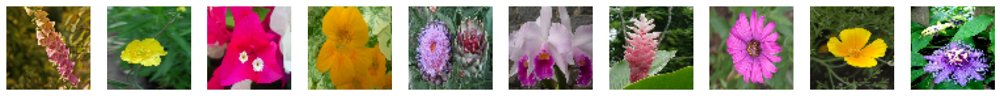

In [11]:
# 훈련 세트에 있는 몇 개의 꽃 이미지를 출력합니다.
train_sample = sample_batch(train)
display(train_sample)

### 1.1 확산 스케줄 <a name="diffusion_schedules"></a>

In [12]:
# diffusion 모델이 단계에 따라 어떻게 노이즈를 추가하는지 정의한다.(선형 방식)
def linear_diffusion_schedule(diffusion_times): # diffusion time은 환산 단계를 나타냄
    min_rate = 0.0001
    max_rate = 0.02
    # diffusion_times를 기반으로 베타 값을 정의
    betas = min_rate + diffusion_times * (max_rate - min_rate)
    # 베타값으로 알파 값을 정의
    alphas = 1 - betas
    # 남아 있는 원래 신호의 양을 계산하기 위한 알파값의 누적곱 설정
    alpha_bars = tf.math.cumprod(alphas)
    # 알파바를 이용해서 ddim의 진행 을 구현
    signal_rates = tf.sqrt(alpha_bars)
    noise_rates = tf.sqrt(1 - alpha_bars)
    return noise_rates, signal_rates

In [13]:
# 이전의 선형 시케줄이 아닌 코사인 스케줄을 정의한다.
def cosine_diffusion_schedule(diffusion_times):
  # 신호 비율과 노이즈 비율을 [0,pi/2]의 코사인 값을 이용해서 정한다.
    signal_rates = tf.cos(diffusion_times * math.pi / 2)
    noise_rates = tf.sin(diffusion_times * math.pi / 2)
    return noise_rates, signal_rates

In [14]:
# 확산 과정에서 신호, 노이즈 범위를 조정(기존 코사인 스케줄와 달리 범위를 설정 할 수 있다.)
def offset_cosine_diffusion_schedule(diffusion_times):
    min_signal_rate = 0.02
    max_signal_rate = 0.95
    # 각도를 구하기 위해서 코사인 역함수를 이용해서 범위를 구한다.
    start_angle = tf.acos(max_signal_rate)
    end_angle = tf.acos(min_signal_rate)
  #확산 단계에 따라서 확산 각도가 변하도록 설정
    diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)
  #각 단계에따라 신호와 노이즈 비율을 정함
    signal_rates = tf.cos(diffusion_angles)
    noise_rates = tf.sin(diffusion_angles)

    return noise_rates, signal_rates

In [15]:
# 설정한 선형, 코사인, 오프셋코사인 방식으로 확산할때의 노이즈,신호비율을 살펴본다.

T = 1000 # 단계는 1000으로 설정
# 0부터 1까지 T만큼을 균등하게 조각낸 배열을 생성하고 그걸 diffusion_time으로 정의
diffusion_times = tf.convert_to_tensor([x / T for x in range(T)])
linear_noise_rates, linear_signal_rates = linear_diffusion_schedule(
    diffusion_times
)
cosine_noise_rates, cosine_signal_rates = cosine_diffusion_schedule(
    diffusion_times
)
(
    offset_cosine_noise_rates,
    offset_cosine_signal_rates,
) = offset_cosine_diffusion_schedule(diffusion_times)

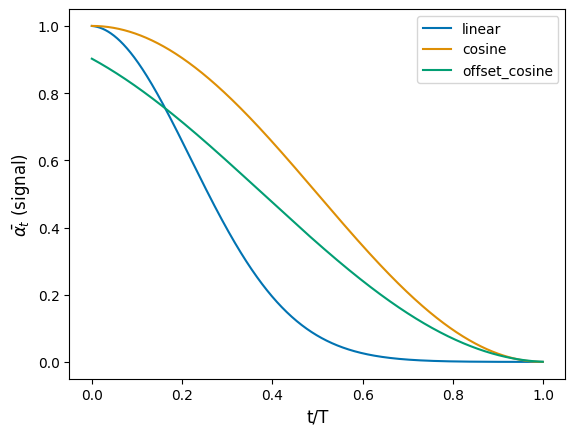

In [16]:
# 단계에 따라 신호 비율이 어떻게 되는지 그래프를 그린다.
plt.plot(
    diffusion_times, linear_signal_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_signal_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_signal_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)
# T에 따른 간뎨가 어느정도 진행되는지 표시한다.
plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12)
plt.legend()
plt.show()

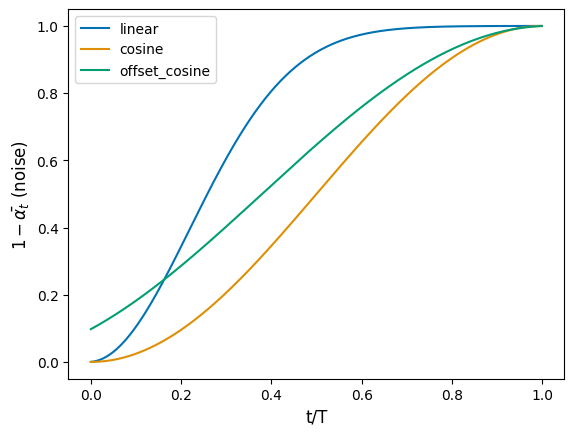

In [17]:
# 단계에 따른 노이즈 비율의 그래프를 그린다.
plt.plot(
    diffusion_times, linear_noise_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_noise_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_noise_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$1-\bar{\alpha_t}$ (noise)", fontsize=12)
plt.legend()
plt.show()
# 코사인이 선형 그래프에 비해 완만한 이유는 코사인 그래프가 처음에는 변화량이 선형 그래프에 비해서 둔하기 때문
#오프셋 코사인은 코사인범위를 절단 시켰다고 생각하면 되기에 그래프는 범위에 따라 다양한 추세를 띈다.

## 2. 모델 구축 <a name="build"></a>

In [18]:
# 입력에 대해서 연속적인 값을 모델에 잘 전달하기 위해서 사인, 코사인 임베딩 생성
def sinusoidal_embedding(x):
    # 1부터 1000까지 로그 스케일로 분포된 주파수 배열 생성
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,
        )
    )
    #x에 따라서 사인 코사인 파를 생성한다.
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings

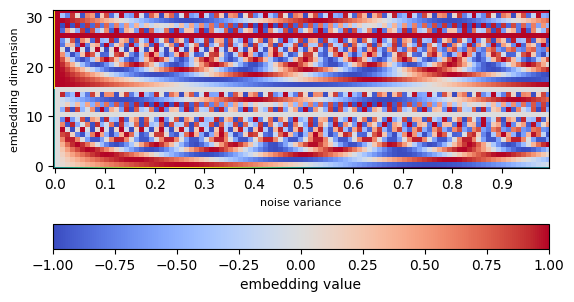

In [19]:
embedding_list = []
# 임베딩 생성
for y in np.arange(0, 1, 0.01):
    embedding_list.append(sinusoidal_embedding(np.array([[[[y]]]]))[0][0][0])
embedding_array = np.array(np.transpose(embedding_list))
fig, ax = plt.subplots()
# X축과 Y축의 눈금을 설정한다.
ax.set_xticks(
    np.arange(0, 100, 10), labels=np.round(np.arange(0.0, 1.0, 0.1), 1)
)
ax.set_ylabel("embedding dimension", fontsize=8)
ax.set_xlabel("noise variance", fontsize=8)
# 임베딩 값들을 색상으로 표현
plt.pcolor(embedding_array, cmap="coolwarm")
# 컬러바를 추가해서 각 색상이 어떤 임베딩 값인지 알려준다.
plt.colorbar(orientation="horizontal", label="embedding value")
# 임베딩 값을 그래프로 나타낸다
ax.imshow(embedding_array, interpolation="nearest", origin="lower")
plt.show()

In [20]:
# U-net의 구조를 정의 하기 위한 블럭들을 정의 한다.
# 잔차 블럭을 정의
def ResidualBlock(width):# width는 레이어의 출력 채널 수
    def apply(x):
        # 입력 x의 채널수와 width가 다른 경우에 1x1컨볼루션을 통해 채널수를 맞춰준다.
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        # Batch normalization을 수행
        x = layers.BatchNormalization(center=False, scale=False)(x)
        # 커널을 2번 겹쳐서 작업한다.
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        # 원래 입력 (residual)과 커널을 통과한 결과를 더한다.
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    # 입력한 block_depth만큼 ResidualBlock을 반복한다.
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            # 잔차블럭의 값을 skip 배열에 저장한다.
            skips.append(x)
        # 풀링을 통한 다운 샘플링을 시도한다.
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        # 업샘플링을 block_depth만큼 시도한다.
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
          # skip 리스트의 값을 꺼내와서 출력과 결합한다.
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply

In [21]:
# U-Net 구축
# 노이즈가 추가된 이미지를 입력한다.(이미지 사이즈와, RGB채널)
noisy_images = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
# 입력 이미지에 1X1 컨볼루션을 적용시킨다.
x = layers.Conv2D(32, kernel_size=1)(noisy_images)
# 노이즈 분산을 명시
noise_variances = layers.Input(shape=(1, 1, 1))
# 노이즈의 분산을 이용해서 임베딩을 생성하고 입력 이미지와 같게 업샘플링한다.
noise_embedding = layers.Lambda(sinusoidal_embedding)(noise_variances)
noise_embedding = layers.UpSampling2D(size=IMAGE_SIZE, interpolation="nearest")(
    noise_embedding
)
# 초기 컨볼루션 레이어와 임베딩을 연결한다.
x = layers.Concatenate()([x, noise_embedding])

skips = []
# 기존에 정의한 다운 블록을 이용해서 다운 샘플링을 시도한다.
x = DownBlock(32, block_depth=2)([x, skips])
x = DownBlock(64, block_depth=2)([x, skips])
x = DownBlock(96, block_depth=2)([x, skips])
# 잔차 블럭을 적용
x = ResidualBlock(128)(x)
x = ResidualBlock(128)(x)
# 업샘플링을 해서 원래대로 복원한다.
x = UpBlock(96, block_depth=2)([x, skips])
x = UpBlock(64, block_depth=2)([x, skips])
x = UpBlock(32, block_depth=2)([x, skips])

x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

unet = models.Model([noisy_images, noise_variances], x, name="unet")

In [22]:
# 확산모델을 구현하는 클래스를 구현한다.
class DiffusionModel(models.Model):
  # 클래스 초기화 함수 정의
    def __init__(self):
        super().__init__()
        # 이미지를 정규화하는 레이어
        self.normalizer = layers.Normalization()
        # 이미지 생성 및 복원을 수행하는 모델 지정
        self.network = unet
        self.ema_network = models.clone_model(self.network)
        # 확산 일정을 계산하는 함수
        self.diffusion_schedule = offset_cosine_diffusion_schedule
    # 상위 클래스의 compile메소드를 호출하여 컴파일 설정을 수행
    def compile(self, **kwargs):
        super().compile(**kwargs)
        # 노이즈 예측 손실을 추적하는 metrics.Mean 객체 생성
        self.noise_loss_tracker = metrics.Mean(name="n_loss")

    @property
    def metrics(self):
        return [self.noise_loss_tracker]
    # 정규화된 이미지를 원래 범위로 되돌린다.
    def denormalize(self, images):
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)
    # 노이즈가 있는 이미지와 해당 노이즈 비율을 받아서 노이즈를 예측하고 제거한다.
    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        if training:
            network = self.network
        else:
            network = self.ema_network
        # 네트워크를 통해서 노이즈를 예측한다.
        pred_noises = network(
            [noisy_images, noise_rates**2], training=training
        )
        # 예측된 노이즈를 사용하여 이미지에서 노이즈를 제거
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps
        current_images = initial_noise
        # 역확산과정을 반복한다.
        for step in range(diffusion_steps):
            # 현재 단계에서 환산 단계를 계산
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            # 현재 확산 단계에 따른 신호, 노이즈 비율 계산
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            # 현재 이미지에서 노이즈를 예측하고 제거
            pred_noises, pred_images = self.denoise(
                current_images, noise_rates, signal_rates, training=False
            )
            # 다음 단계를 위한 값 계산
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            # 다음 단계 이미지 업데이트
            current_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
        return pred_images

    def generate(self, num_images, diffusion_steps, initial_noise=None):
        # 초기 잡음이 없으면 무작위로 생성된 잡음을 배정한다.
        if initial_noise is None:
            initial_noise = tf.random.normal(
                shape=(num_images, IMAGE_SIZE, IMAGE_SIZE, 3)
            )
        # 초기 잡음으로부터 이미지 생성
        generated_images = self.reverse_diffusion(
            initial_noise, diffusion_steps
        )
        # 생성된 이미지를 정규화의 역과정을 거쳐서 원래의 과정으로 되돌린다.
        generated_images = self.denormalize(generated_images)
        return generated_images
    # 모델의 학습단계를 정의
    def train_step(self, images):
      # 입력 이미지를 정규화
        images = self.normalizer(images, training=True)
        # 노이즈를 생성
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        # 확산 단계를 무작위로 선택
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        # 확산 단계에 따라서 노이즈 및 신호 속도를 결정한다.
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # 원본 이미지와 노이즈를 결합해서 노이즈 이미지 생성
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # 잡음 이미지에서 잡음을 구분하도록 훈련
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # 훈련에 사용

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        # 계산한 기울기를 통해서 가중치를 업데이트한다.
        self.optimizer.apply_gradients(
            zip(gradients, self.network.trainable_weights)
        )

        self.noise_loss_tracker.update_state(noise_loss)
        # EMA 네트워크의 가중치를 업데이트한다.
        for weight, ema_weight in zip(
            self.network.weights, self.ema_network.weights
        ):
            ema_weight.assign(EMA * ema_weight + (1 - EMA) * weight)

        return {m.name: m.result() for m in self.metrics}
    # 테스트 단계를 정의한다. (훈련 단계와 유사)
    def test_step(self, images):
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises
        # 노이즈 및 노이즈 제거 이미지 예측
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )
        # 노이즈 손실 예측
        noise_loss = self.loss(noises, pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)

        return {m.name: m.result() for m in self.metrics}

In [23]:
# 확산 모델 초기화한다.
ddm = DiffusionModel()
# 훈련데이터를 통해서 정규화를 시킨다.
ddm.normalizer.adapt(train)

In [24]:

if LOAD_MODEL:
  # 자동 빌드 프로세스를 우회해서 가중치를 직접 업데이트하므로 모델의 빌드 속성을 TRUE로 수동 설정
    ddm.built = True
    # 저장된 파일에서 모델에 가중치를 업데이트
    ddm.load_weights("./checkpoint/checkpoint.ckpt")

## 3.모델 훈련 <a name="train"></a>

In [25]:

ddm.compile(
    # 아담 옵티마이저를 이용해서 최적화 적용
    optimizer=optimizers.experimental.AdamW(
        # 학습 속도, 가중치 감쇠율 설정
        learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    ),
    # 손실 함수를 MAE로 설정
    loss=losses.mean_absolute_error,
)

Epoch 1/50
639/639 [==============================] - ETA: 0s - n_loss: 0.2335
Saved to ./output/generated_img_000.png


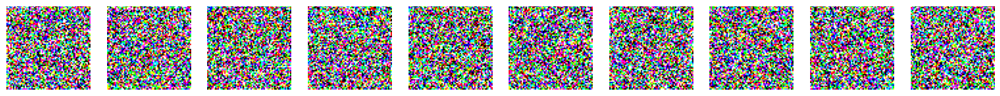

639/639 [==============================] - 112s 129ms/step - n_loss: 0.2335
Epoch 2/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1956
Saved to ./output/generated_img_001.png


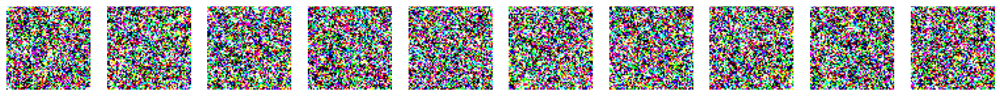

639/639 [==============================] - 91s 140ms/step - n_loss: 0.1956
Epoch 3/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1894
Saved to ./output/generated_img_002.png


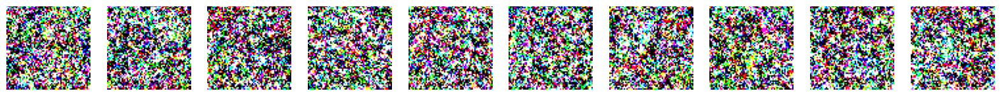

639/639 [==============================] - 91s 141ms/step - n_loss: 0.1894
Epoch 4/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1853
Saved to ./output/generated_img_003.png


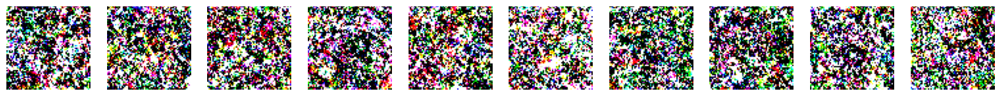

639/639 [==============================] - 100s 155ms/step - n_loss: 0.1853
Epoch 5/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1838
Saved to ./output/generated_img_004.png


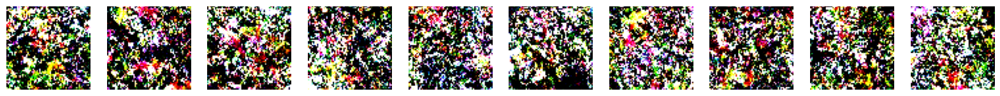

639/639 [==============================] - 95s 146ms/step - n_loss: 0.1838
Epoch 6/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1820
Saved to ./output/generated_img_005.png


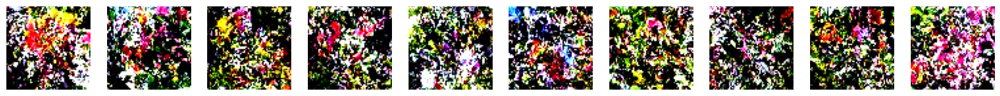

639/639 [==============================] - 106s 164ms/step - n_loss: 0.1820
Epoch 7/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1804
Saved to ./output/generated_img_006.png


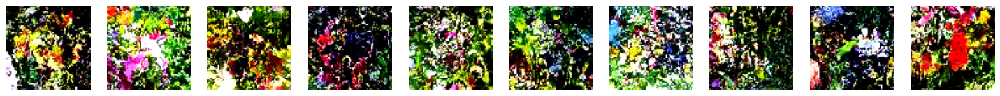

639/639 [==============================] - 99s 153ms/step - n_loss: 0.1804
Epoch 8/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1803
Saved to ./output/generated_img_007.png


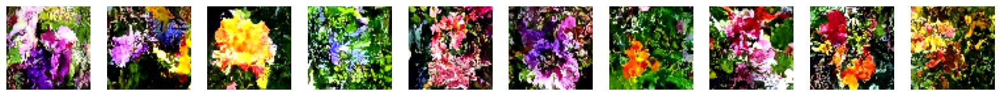

639/639 [==============================] - 110s 168ms/step - n_loss: 0.1803
Epoch 9/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1785
Saved to ./output/generated_img_008.png


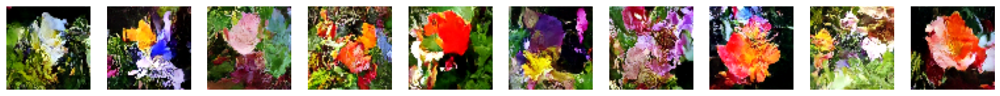

639/639 [==============================] - 115s 179ms/step - n_loss: 0.1785
Epoch 10/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1778
Saved to ./output/generated_img_009.png


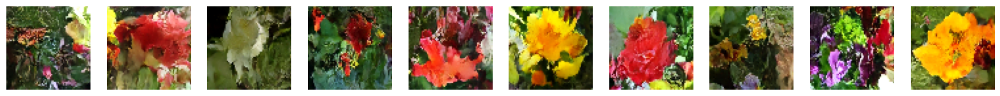

639/639 [==============================] - 106s 163ms/step - n_loss: 0.1778
Epoch 11/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1776
Saved to ./output/generated_img_010.png


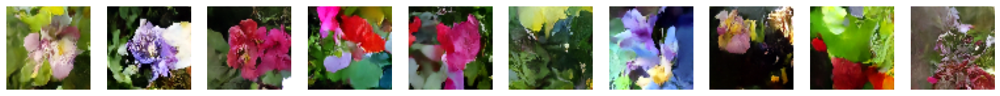

639/639 [==============================] - 108s 168ms/step - n_loss: 0.1776
Epoch 12/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1780
Saved to ./output/generated_img_011.png


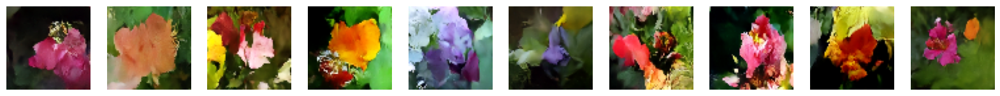

639/639 [==============================] - 109s 169ms/step - n_loss: 0.1780
Epoch 13/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1777
Saved to ./output/generated_img_012.png


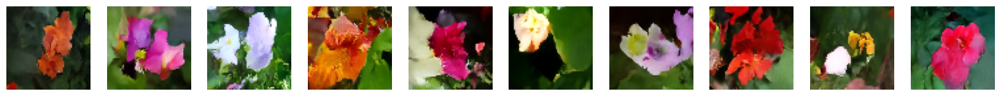

639/639 [==============================] - 108s 167ms/step - n_loss: 0.1777
Epoch 14/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1763
Saved to ./output/generated_img_013.png


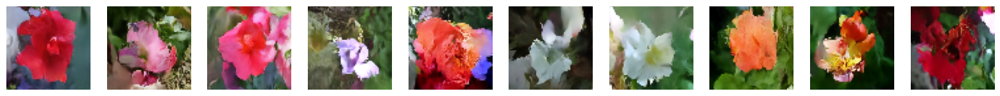

639/639 [==============================] - 110s 169ms/step - n_loss: 0.1763
Epoch 15/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1767
Saved to ./output/generated_img_014.png


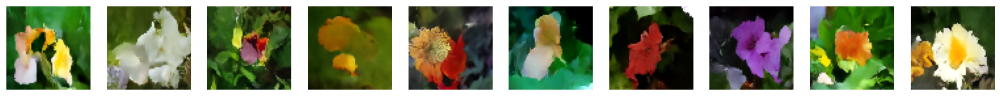

639/639 [==============================] - 116s 180ms/step - n_loss: 0.1767
Epoch 16/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1757
Saved to ./output/generated_img_015.png


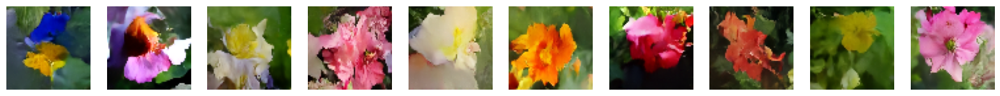

639/639 [==============================] - 133s 206ms/step - n_loss: 0.1757
Epoch 17/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1754
Saved to ./output/generated_img_016.png


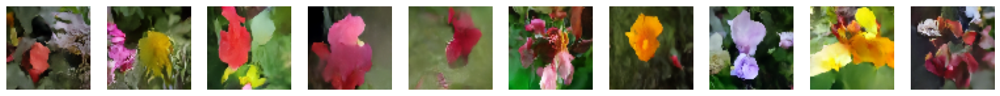

639/639 [==============================] - 131s 200ms/step - n_loss: 0.1754
Epoch 18/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1751
Saved to ./output/generated_img_017.png


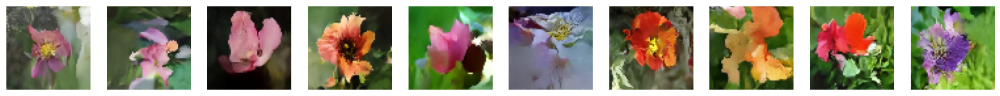

639/639 [==============================] - 129s 200ms/step - n_loss: 0.1751
Epoch 19/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1752
Saved to ./output/generated_img_018.png


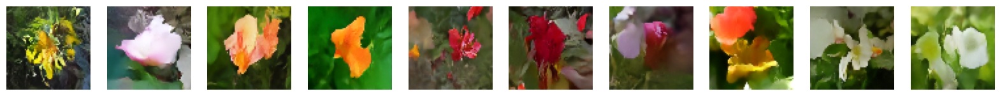

639/639 [==============================] - 132s 204ms/step - n_loss: 0.1752
Epoch 20/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1754
Saved to ./output/generated_img_019.png


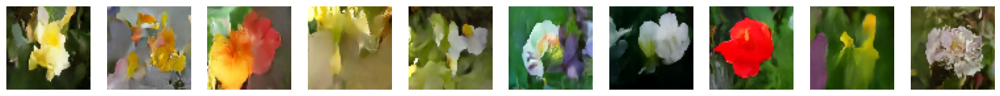

639/639 [==============================] - 119s 183ms/step - n_loss: 0.1754
Epoch 21/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1740
Saved to ./output/generated_img_020.png


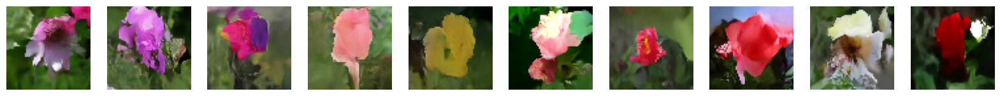

639/639 [==============================] - 127s 196ms/step - n_loss: 0.1740
Epoch 22/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1743
Saved to ./output/generated_img_021.png


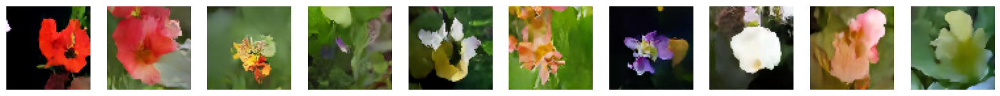

639/639 [==============================] - 123s 190ms/step - n_loss: 0.1743
Epoch 23/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1739
Saved to ./output/generated_img_022.png


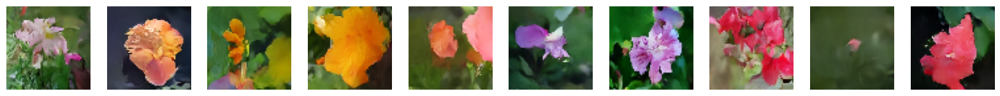

639/639 [==============================] - 132s 204ms/step - n_loss: 0.1739
Epoch 24/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1734
Saved to ./output/generated_img_023.png


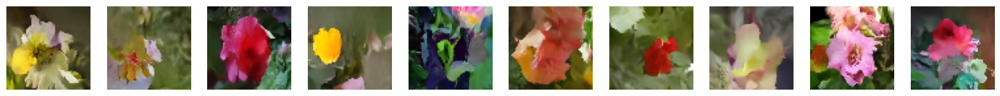

639/639 [==============================] - 130s 202ms/step - n_loss: 0.1734
Epoch 25/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1741
Saved to ./output/generated_img_024.png


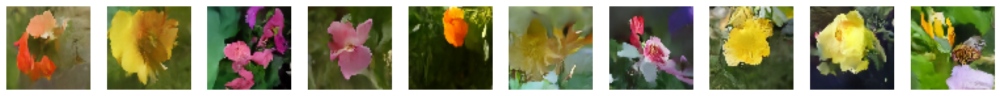

639/639 [==============================] - 136s 208ms/step - n_loss: 0.1741
Epoch 26/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1736
Saved to ./output/generated_img_025.png


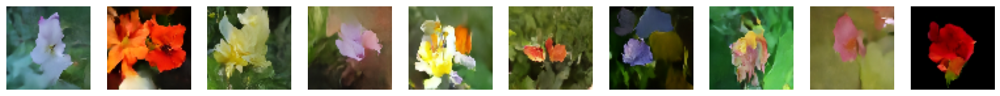

639/639 [==============================] - 149s 228ms/step - n_loss: 0.1736
Epoch 27/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1738
Saved to ./output/generated_img_026.png


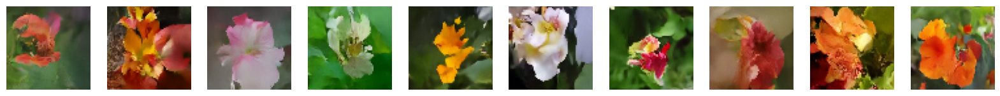

639/639 [==============================] - 133s 205ms/step - n_loss: 0.1738
Epoch 28/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_027.png


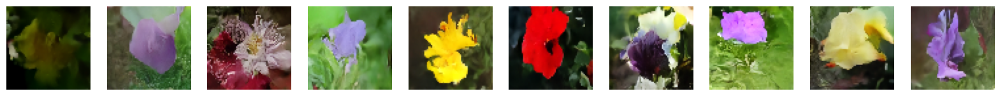

639/639 [==============================] - 141s 219ms/step - n_loss: 0.1731
Epoch 29/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1741
Saved to ./output/generated_img_028.png


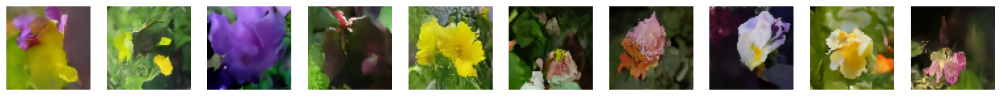

639/639 [==============================] - 126s 194ms/step - n_loss: 0.1741
Epoch 30/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1736
Saved to ./output/generated_img_029.png


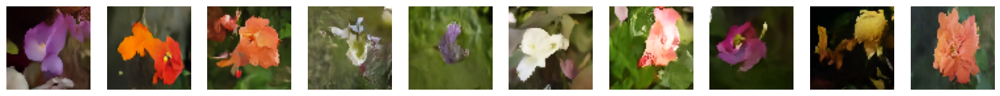

639/639 [==============================] - 135s 210ms/step - n_loss: 0.1736
Epoch 31/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1734
Saved to ./output/generated_img_030.png


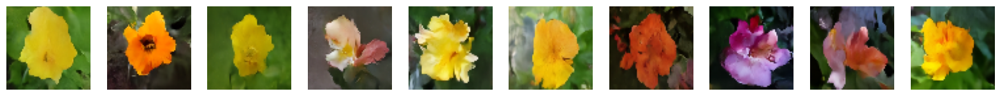

639/639 [==============================] - 146s 225ms/step - n_loss: 0.1734
Epoch 32/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_031.png


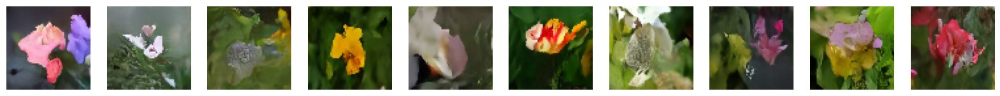

639/639 [==============================] - 151s 234ms/step - n_loss: 0.1731
Epoch 33/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_032.png


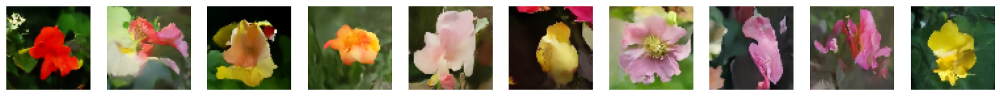

639/639 [==============================] - 124s 192ms/step - n_loss: 0.1731
Epoch 34/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_033.png


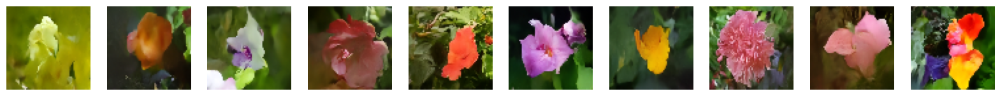

639/639 [==============================] - 123s 189ms/step - n_loss: 0.1731
Epoch 35/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1724
Saved to ./output/generated_img_034.png


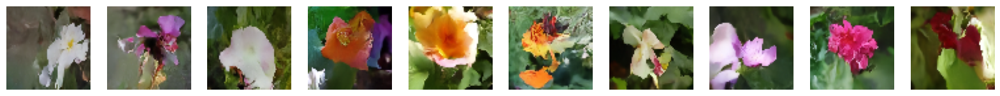

639/639 [==============================] - 124s 190ms/step - n_loss: 0.1724
Epoch 36/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1726
Saved to ./output/generated_img_035.png


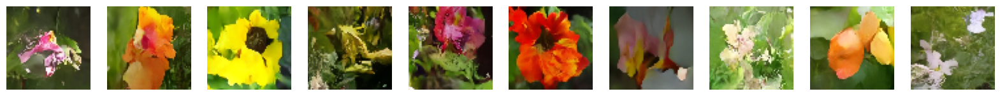

639/639 [==============================] - 126s 193ms/step - n_loss: 0.1726
Epoch 37/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1714
Saved to ./output/generated_img_036.png


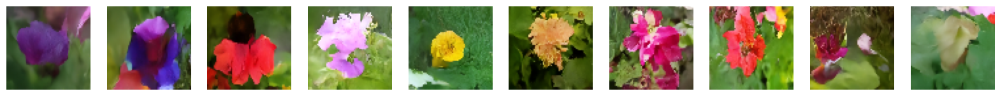

639/639 [==============================] - 123s 190ms/step - n_loss: 0.1714
Epoch 38/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1727
Saved to ./output/generated_img_037.png


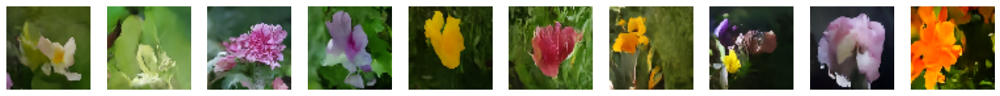

639/639 [==============================] - 124s 191ms/step - n_loss: 0.1727
Epoch 39/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719
Saved to ./output/generated_img_038.png


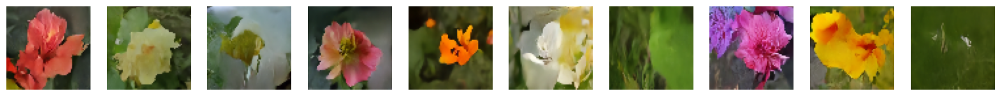

639/639 [==============================] - 125s 192ms/step - n_loss: 0.1719
Epoch 40/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1721
Saved to ./output/generated_img_039.png


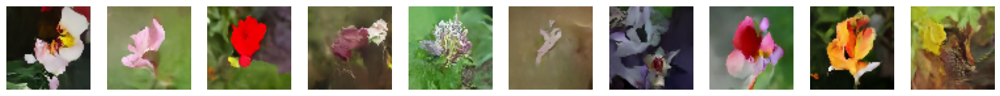

639/639 [==============================] - 123s 190ms/step - n_loss: 0.1721
Epoch 41/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1721
Saved to ./output/generated_img_040.png


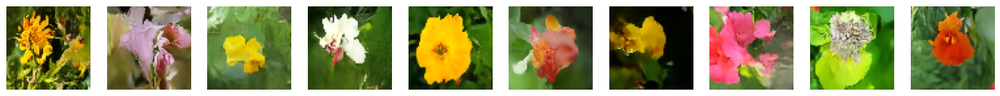

639/639 [==============================] - 125s 193ms/step - n_loss: 0.1721
Epoch 42/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1724
Saved to ./output/generated_img_041.png


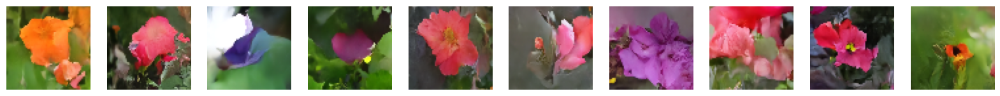

639/639 [==============================] - 123s 189ms/step - n_loss: 0.1724
Epoch 43/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1723
Saved to ./output/generated_img_042.png


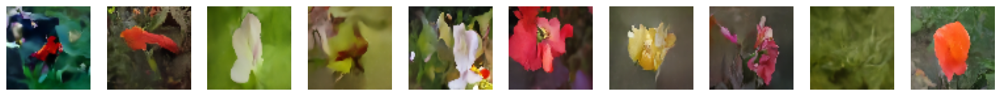

639/639 [==============================] - 124s 191ms/step - n_loss: 0.1723
Epoch 44/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1724
Saved to ./output/generated_img_043.png


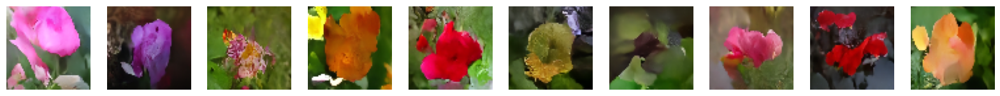

639/639 [==============================] - 129s 198ms/step - n_loss: 0.1724
Epoch 45/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1715
Saved to ./output/generated_img_044.png


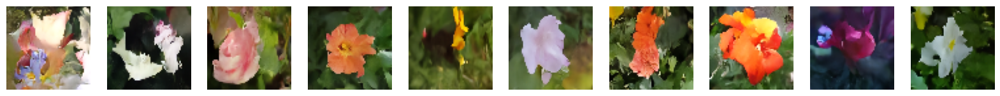

639/639 [==============================] - 131s 202ms/step - n_loss: 0.1715
Epoch 46/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1717
Saved to ./output/generated_img_045.png


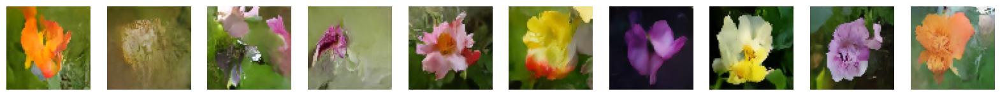

639/639 [==============================] - 132s 202ms/step - n_loss: 0.1717
Epoch 47/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1715
Saved to ./output/generated_img_046.png


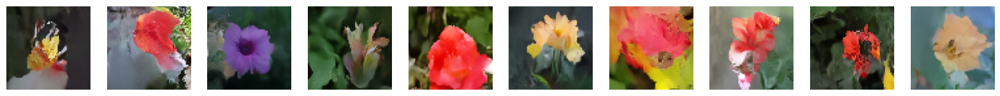

639/639 [==============================] - 133s 204ms/step - n_loss: 0.1715
Epoch 48/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1714
Saved to ./output/generated_img_047.png


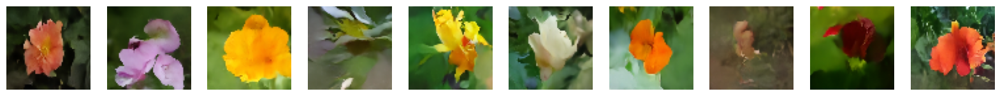

639/639 [==============================] - 126s 194ms/step - n_loss: 0.1714
Epoch 49/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1725
Saved to ./output/generated_img_048.png


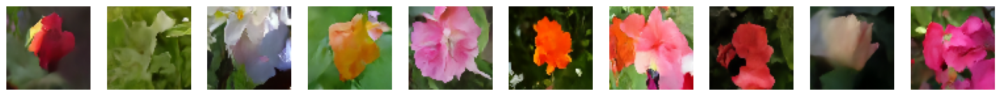

639/639 [==============================] - 124s 191ms/step - n_loss: 0.1725
Epoch 50/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1721
Saved to ./output/generated_img_049.png


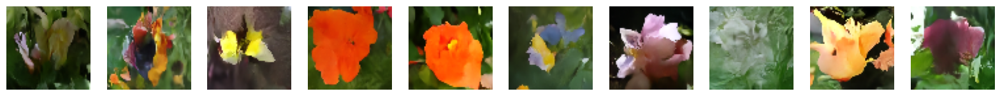

639/639 [==============================] - 125s 192ms/step - n_loss: 0.1721


In [26]:
# 훈련을 실행하고 생성된 이미지를 주기적으로 출력합니다.
# 각 에포크가 끝날떄마다 모델의 가중치 저장
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)
# 학습 과정 데이터를 기록해서 시각화
tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")

# 각 에포크가 끝날때 이미지 생성
class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generate(
            num_images=self.num_img,
            diffusion_steps=PLOT_DIFFUSION_STEPS,
        ).numpy()
        # 생성된 이미지 저장
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
        )


image_generator_callback = ImageGenerator(num_img=10)
# 모델을 훈련하는데 사용되는 객체들 설정
ddm.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        image_generator_callback,
    ],
)

## 4. 추론 <a name="inference"></a>

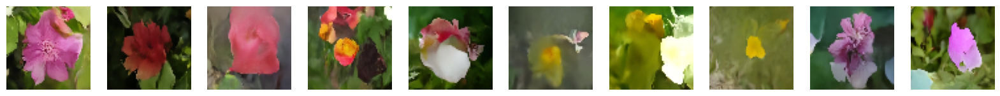

In [27]:
# 새로운 꽃 이미지 생성
generated_images = ddm.generate(num_images=10, diffusion_steps=20).numpy()
display(generated_images)

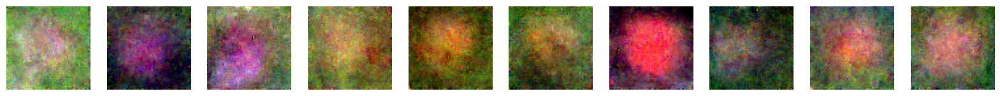

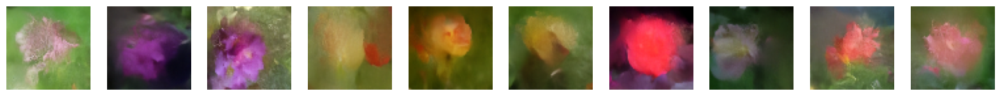

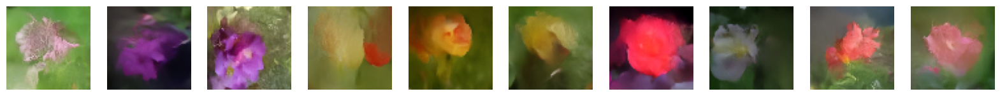

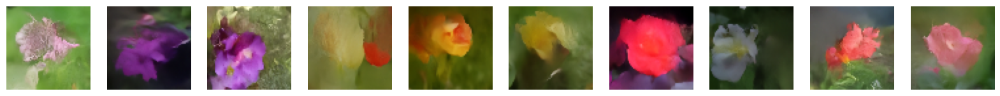

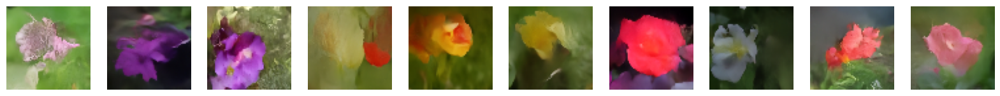

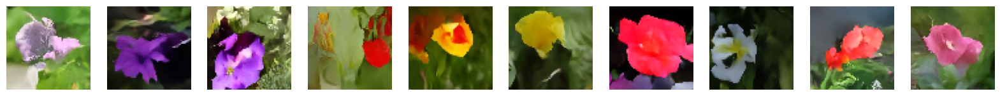

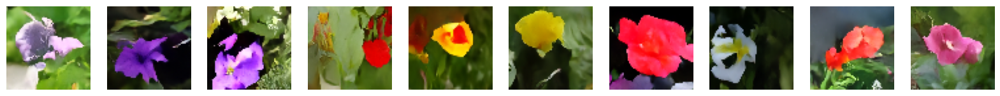

In [28]:
# 확산 단계 증가에 따른 이미지 품질 향상 확인
# 확산 단계를 1,2,3,4,5,20,100을 가져와서 직접 이미지를 살펴봄
for diffusion_steps in list(np.arange(1, 6, 1)) + [20] + [100]:
    tf.random.set_seed(42)
    # 생성 메서드를 호출해서 이미지 생성
    generated_images = ddm.generate(
        num_images=10,
        diffusion_steps=diffusion_steps,
    ).numpy()
    display(generated_images)

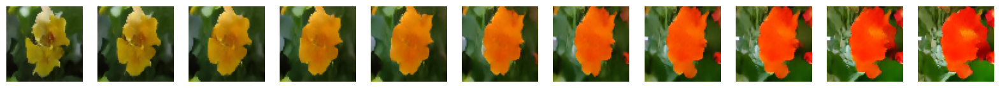

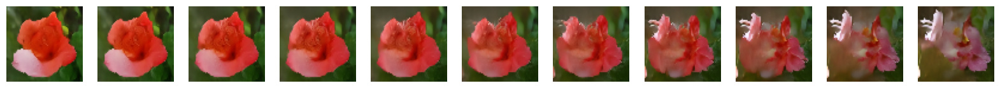

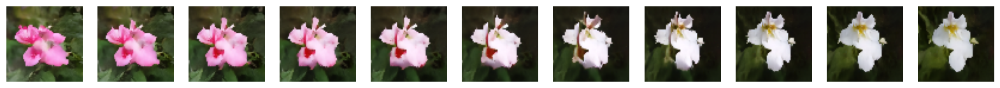

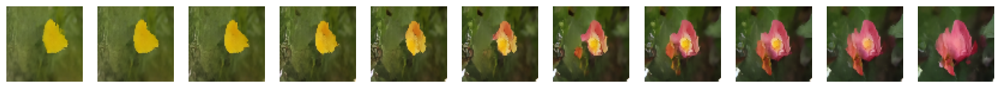

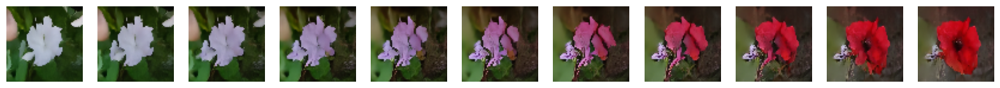

In [29]:
# 잡음 공간에 있는 두 포인트 사이를 보간
tf.random.set_seed(100)

# 두 벡터 a, b 사이에 부형 보간 수행 -> 두상태 사이를 부드럽게 전환
def spherical_interpolation(a, b, t):
    return np.sin(t * math.pi / 2) * a + np.cos(t * math.pi / 2) * b


for i in range(5):

    a = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    b = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))

    # 보간된 노이즈 벡터를 초기노이즈로 사용해서 이미지를 생성
    initial_noise = np.array(
        [spherical_interpolation(a, b, t) for t in np.arange(0, 1.1, 0.1)]
    )
    generated_images = ddm.generate(
        num_images=2, diffusion_steps=20, initial_noise=initial_noise
    ).numpy()
    display(generated_images, n=11)